Animation size has reached 20988227 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


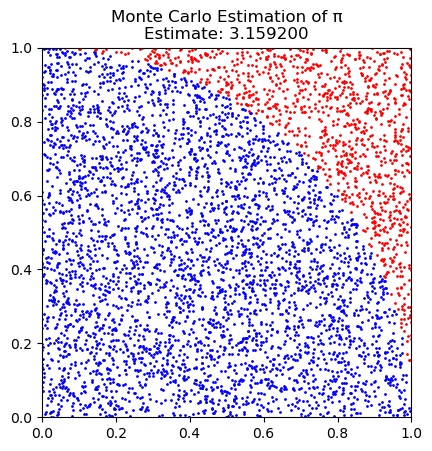

In [2]:
import random
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

#matplotlib.rcParams['animation.embed_limit'] = 600
# Use the inline backend to display animations directly in the notebook
%matplotlib inline

def estimate_pi(num_samples):
    inside_circle = 0
    x_inside = []
    y_inside = []
    x_outside = []
    y_outside = []
    estimates = []

    fig, ax = plt.subplots()
    ax.set_aspect('equal', 'box')
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_title("Monte Carlo Estimation of π")

    inside_points, = ax.plot([], [], 'bo', markersize=1, label="Inside Circle")
    outside_points, = ax.plot([], [], 'ro', markersize=1, label="Outside Circle")

    def update(frame):
        nonlocal inside_circle

        x = random.uniform(0, 1)
        y = random.uniform(0, 1)

        if x**2 + y**2 <= 1:
            x_inside.append(x)
            y_inside.append(y)
            inside_circle += 1
        else:
            x_outside.append(x)
            y_outside.append(y)

        # Update the estimate of pi
        if frame > 0:
            pi_estimate = (inside_circle / frame) * 4
            estimates.append(pi_estimate)

        inside_points.set_data(x_inside, y_inside)
        outside_points.set_data(x_outside, y_outside)

        # Set the plot title with the current estimate of pi
        ax.set_title(f"Monte Carlo Estimation of π\nEstimate: {pi_estimate:.6f}")

        return inside_points, outside_points

    ani = animation.FuncAnimation(fig, update, frames=range(1, num_samples + 1),
                                  interval=10, blit=True, repeat=False)

    # Display the animation in the notebook
    return HTML(ani.to_jshtml())

# Example usage
num_samples = 5000
estimate_pi(num_samples)


In [2]:
%matplotlib inline